# Training Custom ResNet
___

## Table of contents
1. [Imports](#Imports)
2. [LoadData](#LoadData)
3. [Config](#Configs)
4. [Analysis](#Analysis)
5. [Process](#Process)

## Imports

In [1]:
import os
import numpy as np
import pandas as pd

import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import Dataset,DataLoader,random_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision import models, transforms
from torch_lr_finder import LRFinder

from tqdm.notebook import tqdm

import math
import pretrainedmodels as ptm
import h5py
import copy
from datetime import datetime
import matplotlib.pyplot as plt

In [46]:
from Library.datasets import DatasetH5TwoRandom, DatasetH5ForTest, compute_std_mean
from Library.transforms import RandomFlip,RandomOffset,RandomRotateGrayscale
from Library.scheduler import OneCycleLR,LogLR
from Library.cresnet import initialize_cresnet
from Library.dml import RefBasedDeepMetric
from Library.models.FeatureExtractor import FeatureExtractor, Block, CustomNet
from Library.trainers import RefBasedDeepMetricTrainer

In [3]:
from Library.util import (
    jupyter_wide_screen,
    strings_contain_words, 
    strings_contain_patterns, 
    add_unique_entry
)

jupyter_wide_screen()

## LoadData

#### To initialize dataset: obtain References and Dataset object

In [4]:
#### To initialize dataset: obtain References and Dataset object
def init_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []
    
    ### 可能还需要用 transforms.RandomHorizontalFlip()  RandomRotate
    #img_transforms = [transforms.ToTensor(),transforms.Normalize((mean_val,),(std_val,))] # 先标准化处理
    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5TwoRandom(h5_fpath,transform = composed_img_transforms)
        
        # obtain the references, the first 10 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [5]:
# 3 stripes
data_path = "../MA/NewData/22008_1000202026_652510007"
fnames = "regenerated_roi_ms1_seq{}_720x30.h5"
combined_path = os.path.join(data_path, fnames)
seq_idx_list = [4,6,7,8]

In [6]:
# 1 stripe
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [2,3,4]

inputs_shape = [1,720,24]
batch_sizes = [32, 32, 32]
shuffle_flags = [True, False, False]
ds_ratio = [0.6, 0.2, 0.2]

In [7]:
mean_val = 0
std_val = 255
refs_list, ds_h5 = init_dataset(combined_path_type2, seq_idx_list_type2, mean_val, std_val)

In [8]:
len(refs_list)

3

#### Dataloader for training set ,validation set, test set (60%,20%,20%)

In [9]:
def init_dataloaders(datasets,ds_ratio):
    dataloaders = []
    
    for ds in datasets:
        splitted_ds_num_data = [round(len(ds) * ds_ratio[i]) for i in range(len(ds_ratio))]
        splitted_ds_num_data[0] += len(ds) - int(np.sum(splitted_ds_num_data))

        splitted_ds = []

        for tmp_ds, batch_size, shuffle in zip(random_split(ds, splitted_ds_num_data), batch_sizes, shuffle_flags):

            splitted_ds.append(
                DataLoader(
                    tmp_ds,
                    batch_size=batch_size,
                    shuffle=shuffle,
                    drop_last=True,
                )
            )

        dataloaders.append(splitted_ds)
    return dataloaders

In [10]:
dataloaders = init_dataloaders(ds_h5, ds_ratio)

train_dls = [dls[0] for dls in dataloaders]
valid_dls = [dls[1] for dls in dataloaders]
test_dls = [dls[2] for dls in dataloaders]

## FeatureExtractor

In [11]:
class FeatureExtractor(nn.Module):
    # Custom feature extraction model from pretrained ResNet50

    def __init__(self, model,zero_init_residual=False):
        super(FeatureExtractor, self).__init__()
        
        self.conv1= nn.Conv2d(1, 64, 3, (2,1), 1)
        self.bn1 = model.bn1
        #self.relu = nn.LeakyReLU(inplace = True)
        self.relu = model.relu
        self.maxpool = model.maxpool

        self.layer1 = model.layer1
        self.layer2 = model.layer2

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Sequential(nn.Linear(128, 64))
                
        # weights initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode = 'fan_in', nonlinearity = 'leaky_relu')

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        self.featuremap0 = x.detach() # 核心代码

        x = self.layer1(x)
        self.featuremap1 = x.detach() # 核心代码
        
        x = self.layer2(x)
        self.featuremap2 = x.detach() # 核心代码
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)

        x = self.fc(x)
        self.featuremapfc = x.detach() # 核心代码
        
        return x
    
    def show_intermediate_shape(self, x):
    
        x = self.conv1(x)
        print("In conv1: ", x.shape)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print("In maxpool: ", x.shape)
        x = self.layer1(x)
        print("In layer1: ", x.shape)
        x = self.layer2(x)
        print("In layer2: ", x.shape)
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)
        x = self.fc(x)
        print("In FC: ", x.shape)

## SiameseNet structure

In [12]:
class SiameseNet(nn.Module):
    def __init__(self, model):
        super(SiameseNet, self).__init__()
        self.model = model
        
    def _calculate_loss(self, v1, v2, refs_tensor):
        r"""Calculate distance between vector of img1&img2 and each reference images

        Args:
            v1 (Tensor, torch.Size[batchsize,128]): batch of img1s from feature extractor
            v2 (Tensor, torch.Size[batchsize,128]): batch of img2s from feature extractor
            refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
        """
        v_dim = v1.size(1)
        num_ref = refs_tensor.size(0)

        v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
        v22 = v2.unsqueeze(1).repeat(1, num_ref, 1)
        refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size

        kernel_matrix1 = (v11-refs).pow(2).sum(2) #torch.Size([batchsize, 10])
        kernel_matrix2 = (v22-refs).pow(2).sum(2) #torch.Size([batchsize, 10])

        v1_distance_mean = torch.mean(kernel_matrix1,dim = 1) #torch.Size([batchsize])
        v2_distance_mean = torch.mean(kernel_matrix2,dim = 1) #torch.Size([batchsize])
        
        diff = v1_distance_mean - v2_distance_mean
        
        #print("Before Sigmoid outputs",outputs)
        sigmoid = nn.Sigmoid()
        outputs = sigmoid(diff)
        #print("After Sigmoid outputs",outputs)

        return outputs

    def forward(self, x1, x2, refs):
        v1 = self.model(x1)
        v2 = self.model(x2)
        feature_refs = self.model(refs)
        
        outputs = self._calculate_loss(v1, v2, feature_refs)
        return outputs
    
    # This function used to plot the degradation metric , x1 is the sequential image
    def forward_test(self, x1, refs):
        v1 = self.model(x1)
        feature_refs = self.model(refs)
        
        return v1, feature_refs
    
    def get_model(self, x):
        return self.model(x)


#### Load pretrained ResNet

In [25]:
res_model = models.resnet34(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
#model = SiameseNet(feature_extractor)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, aff

In [14]:
inputs = torch.randn(1,1,720,24)
model.feature_extractor.show_intermediate_shape(inputs.to(device))

In conv1:  torch.Size([1, 64, 360, 24])
In maxpool:  torch.Size([1, 64, 180, 12])
In layer1:  torch.Size([1, 64, 180, 12])
In layer2:  torch.Size([1, 128, 90, 6])
In FC:  torch.Size([1, 64])


## Learning Rate Test

In [15]:
from torch.optim.lr_scheduler import _LRScheduler
from torch_lr_finder import LRFinder ,TrainDataLoaderIter, ValDataLoaderIter

In [16]:
class CustomTrainIter(TrainDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels
    
    def __next__(self):
        try:
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)

        return img1, img2, labels

In [17]:
class CustomValIter(ValDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels

In [18]:
class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]

In [19]:
class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        # In earlier Pytorch versions last_epoch starts at -1, while in recent versions
        # it starts at 0. We need to adjust the math a bit to handle this. See
        # discussion at: https://github.com/davidtvs/pytorch-lr-finder/pull/42
        
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]

In [20]:
try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    IS_AMP_AVAILABLE = False
    
class CustomLRFinder(LRFinder):
    
    def custom_range_test(
        self,
        train_loader,
        curr_refs,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
        non_blocking_transfer=True,
    ):
       
        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        if isinstance(train_loader, DataLoader):
            train_iter = TrainDataLoaderIter(train_loader)
        elif isinstance(train_loader, TrainDataLoaderIter):
            train_iter = train_loader
        else:
            raise ValueError(
                "`train_loader` has unsupported type: {}."
                "Expected types are `torch.utils.data.DataLoader`"
                "or child of `TrainDataLoaderIter`.".format(type(train_loader))
            )

        if val_loader:
            if isinstance(val_loader, DataLoader):
                val_iter = CustomValIter(val_loader)
            elif isinstance(val_loader, ValDataLoaderIter):
                val_iter = val_loader
            else:
                raise ValueError(
                    "`val_loader` has unsupported type: {}."
                    "Expected types are `torch.utils.data.DataLoader`"
                    "or child of `ValDataLoaderIter`.".format(type(val_loader))
                )

        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(
                train_iter,
                curr_refs,
                accumulation_steps,
                non_blocking_transfer= non_blocking_transfer,
            )
            if val_loader:
                loss = self._validate(
                    val_iter, curr_refs, non_blocking_transfer=non_blocking_transfer
                )

            # Update the learning rate
            self.history["lr"].append(lr_schedule.get_lr()[0])
            lr_schedule.step()

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _train_batch(self, train_iter, curr_refs, accumulation_steps, non_blocking_transfer=True):
        self.model.train()
        total_loss = None  # for late initialization
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.optimizer.zero_grad()
        curr_refs = curr_refs.float().to(device)

        for i in range(accumulation_steps):
            img1, img2, labels = next(train_iter)
            labels = labels.view(-1)
            labels = labels.to(device)
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)

            # Forward pass
            loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()
    
    def _validate(self, val_iter, curr_refs, non_blocking_transfer=True):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        curr_refs = curr_refs.float().to(device)
        with torch.no_grad():
            for img1, img2, labels in val_iter:
                # Move data to the correct device
                labels = labels.view(-1)
                labels = labels.to(device)
                img1 = img1.float().to(device)
                img2 = img2.float().to(device)

                # Forward pass and loss computation
                loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)
                running_loss += loss.item() * len(labels)

        return running_loss / len(val_iter.dataset)
    

### LR Test Config

In [21]:
start_lr = 1e-8
end_lr = 1e-1

min_lr_factor   = 0.2
anneal_lr_factor= 1e-1

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2
refs_dl_idx = 0

optimizer = torch.optim.Adam(model.parameters(),lr=start_lr, eps=1e-08, weight_decay=0)
#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)
#criterion = nn.CrossEntropyLoss()
#criterion = nn.BCEWithLogitsLoss(reduction = 'none')
criterion = nn.BCELoss()


Learning rate search finished. See the graph with {finder_name}.plot()


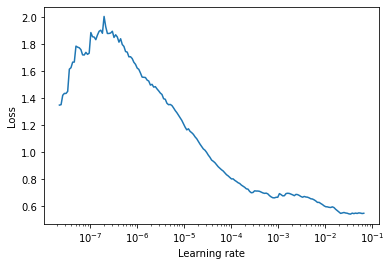

In [22]:
#lr_finder.reset()
lr_finder = CustomLRFinder(model, optimizer, criterion, device="cuda")

# seq dataloader / shuffel the dataloader
for refs, train_dl, val_dl in zip (refs_list, train_dls, valid_dls):
    custom_train_iter = CustomTrainIter(train_dl)
    custom_val_iter = CustomValIter(val_dl)
lr_finder.custom_range_test(custom_train_iter, curr_refs = refs, end_lr=end_lr, num_iter=200)
lr_finder.plot(suggest_lr= False)
lr_finder.reset()

## Training Config

In [26]:
num_epochs = 50

lr = 2e-4

min_lr_factor = 0.1
phases_ratio = [0.3, 0.2, 0.3, 0.2]

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2

run_train = True

net_path = "../MA/save_net/"
criterion = nn.BCELoss()
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']
    
dateTimeObj = datetime.now()
timestampStr = dateTimeObj.strftime("%d-%b-%Y (%H:%M:%S)")
print('Current Timestamp : ', timestampStr)

Current Timestamp :  21-May-2021 (18:07:37)


Total Train Iterations:  548
Total Train Iterations List:  [149, 230, 548]
Valid iterations per seq:  [49, 27, 106]


Train



Sequence:1, Seq Training Mean Loss: 0.6664393934227476, Seq Training Acc: 0.6082214765100671
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.6797828924508742, Seq Training Acc: 0.5787037037037037
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.39488310521503667, Seq Training Acc: 0.820066823899371
******************************************************************
Epoch:1, Epoch Training Loss Mean: 0.5108298063278198, Epoch Training Acc: 0.726790602189781
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6304911776464812, Seq Valid Acc: 0.6460459183673469



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6520243397465458, Seq Valid Acc: 0.6226851851851852



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.3250320733718152, Seq Valid Acc: 0.8576061320754716
Epoch:1, Epoch Valid Mean Loss: 0.45578092336654663, Epoch Valid Acc: 0.7657967032967034
******************************************************************


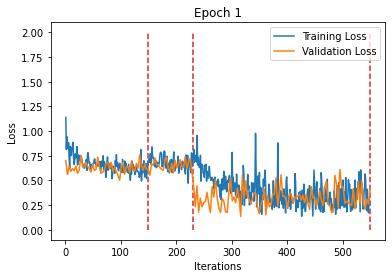

Train



Sequence:1, Seq Training Mean Loss: 0.5390844399096982, Seq Training Acc: 0.7384647651006712
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.5971246542018137, Seq Training Acc: 0.6670524691358025
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.30859246974190074, Seq Training Acc: 0.8668435534591195
******************************************************************
Epoch:2, Epoch Training Loss Mean: 0.41391074657440186, Epoch Training Acc: 0.8024064781021898
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6324314821739586, Seq Valid Acc: 0.6836734693877551



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6595423078095471, Seq Valid Acc: 0.6412037037037037



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2709652123586187, Seq Valid Acc: 0.8835495283018868
Epoch:2, Epoch Valid Mean Loss: 0.42592909932136536, Epoch Valid Acc: 0.7937843406593407
******************************************************************


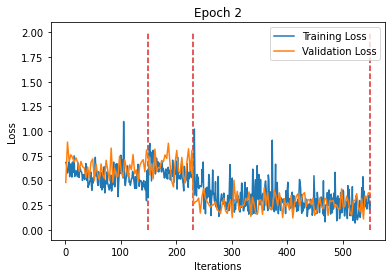

Train



Sequence:1, Seq Training Mean Loss: 0.4834501407290465, Seq Training Acc: 0.7732802013422819
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.5206838235443021, Seq Training Acc: 0.7527006172839507
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.28167012037486777, Seq Training Acc: 0.875687893081761
******************************************************************
Epoch:3, Epoch Training Loss Mean: 0.37186235189437866, Epoch Training Acc: 0.8296646897810219
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.7392507314073796, Seq Valid Acc: 0.7531887755102041



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7475905418395996, Seq Valid Acc: 0.7106481481481481



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.22291769502016734, Seq Valid Acc: 0.9091981132075472
Epoch:3, Epoch Valid Mean Loss: 0.439766526222229, Epoch Valid Acc: 0.8377403846153846
******************************************************************


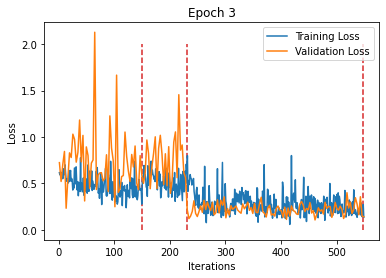

Train



Sequence:1, Seq Training Mean Loss: 0.4149994001092527, Seq Training Acc: 0.8183724832214765
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4656883422975187, Seq Training Acc: 0.7646604938271605
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2792118627390584, Seq Training Acc: 0.883058176100629
******************************************************************
Epoch:4, Epoch Training Loss Mean: 0.3436953127384186, Epoch Training Acc: 0.847969890510949
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6210084739996462, Seq Valid Acc: 0.7576530612244898



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6641211443477206, Seq Valid Acc: 0.6956018518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2828578964438079, Seq Valid Acc: 0.8767688679245284
Epoch:4, Epoch Valid Mean Loss: 0.43045949935913086, Epoch Valid Acc: 0.8178228021978022
******************************************************************


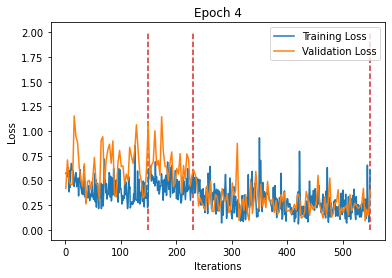

Train



Sequence:1, Seq Training Mean Loss: 0.3605071875272981, Seq Training Acc: 0.8414429530201343
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4551811275290854, Seq Training Acc: 0.7800925925925926
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.29920413643824606, Seq Training Acc: 0.8726415094339622
******************************************************************
Epoch:5, Epoch Training Loss Mean: 0.338927298784256, Epoch Training Acc: 0.8504790145985401
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5439137141315304, Seq Valid Acc: 0.7665816326530612



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.529835272718359, Seq Valid Acc: 0.7268518518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.24648949103254192, Seq Valid Acc: 0.894752358490566
Epoch:5, Epoch Valid Mean Loss: 0.368600070476532, Epoch Valid Acc: 0.8353365384615384
******************************************************************


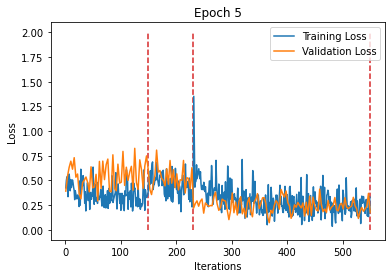

Train



Sequence:1, Seq Training Mean Loss: 0.34840741023521293, Seq Training Acc: 0.8439597315436241
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.42358529733286965, Seq Training Acc: 0.8125
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2509121768551428, Seq Training Acc: 0.8974056603773585
******************************************************************
Epoch:6, Epoch Training Loss Mean: 0.30294376611709595, Epoch Training Acc: 0.8703239051094891
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5402159404997923, Seq Valid Acc: 0.7940051020408163



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.48394258817036945, Seq Valid Acc: 0.7638888888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2669171062561701, Seq Valid Acc: 0.8835495283018868
Epoch:6, Epoch Valid Mean Loss: 0.37269365787506104, Epoch Valid Acc: 0.8416895604395604
******************************************************************


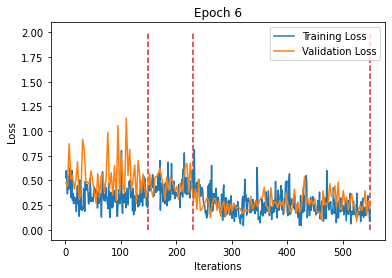

Train



Sequence:1, Seq Training Mean Loss: 0.33296337883744465, Seq Training Acc: 0.8613674496644296
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.42091854210988977, Seq Training Acc: 0.8070987654320988
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2482240439667923, Seq Training Acc: 0.9063482704402516
******************************************************************
Epoch:7, Epoch Training Loss Mean: 0.2967904806137085, Epoch Training Acc: 0.8794479927007299
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5705848190249229, Seq Valid Acc: 0.7684948979591837



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7726864284939237, Seq Valid Acc: 0.6516203703703703



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.313137634323453, Seq Valid Acc: 0.890625
Epoch:7, Epoch Valid Mean Loss: 0.45062515139579773, Epoch Valid Acc: 0.8222870879120879
******************************************************************


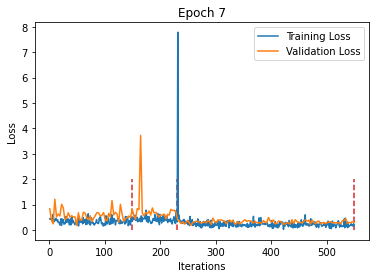

Train



Sequence:1, Seq Training Mean Loss: 0.3554849088091978, Seq Training Acc: 0.8513003355704698
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4015220810233811, Seq Training Acc: 0.8360339506172839
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.21981758715690308, Seq Training Acc: 0.913816823899371
******************************************************************
Epoch:8, Epoch Training Loss Mean: 0.2835630178451538, Epoch Training Acc: 0.8853216240875912
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.570245799361443, Seq Valid Acc: 0.7270408163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6193014913135104, Seq Valid Acc: 0.6875



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.20931160189914252, Seq Valid Acc: 0.9086084905660378
Epoch:8, Epoch Valid Mean Loss: 0.3673088848590851, Epoch Valid Acc: 0.8269230769230769
******************************************************************


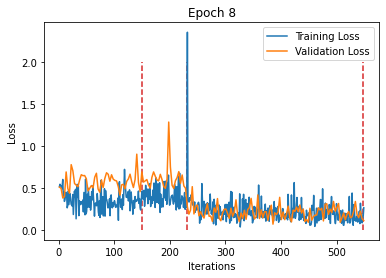

Train



Sequence:1, Seq Training Mean Loss: 0.35275069259157116, Seq Training Acc: 0.8498322147651006
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.39666386960465233, Seq Training Acc: 0.8244598765432098
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2101495847246557, Seq Training Acc: 0.9150943396226415
******************************************************************
Epoch:9, Epoch Training Loss Mean: 0.2764912247657776, Epoch Training Acc: 0.8839530109489051
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5832585196714012, Seq Valid Acc: 0.8271683673469388



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6388300844916591, Seq Valid Acc: 0.7743055555555556



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.21880557528644237, Seq Valid Acc: 0.9068396226415094
Epoch:9, Epoch Valid Mean Loss: 0.3792388439178467, Epoch Valid Acc: 0.865728021978022
******************************************************************


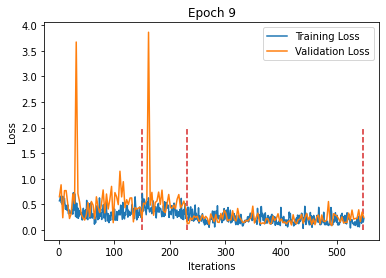

Train



Sequence:1, Seq Training Mean Loss: 0.3075137099863699, Seq Training Acc: 0.8689177852348994
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.42848738991184, Seq Training Acc: 0.808641975308642
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1923500282467349, Seq Training Acc: 0.9205974842767296
******************************************************************
Epoch:10, Epoch Training Loss Mean: 0.25856631994247437, Epoch Training Acc: 0.8899977189781022
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.46935660559303904, Seq Valid Acc: 0.8469387755102041



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5908571658311067, Seq Valid Acc: 0.7152777777777778



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.26153202523600383, Seq Valid Acc: 0.9003537735849056
Epoch:10, Epoch Valid Mean Loss: 0.3663407266139984, Epoch Valid Acc: 0.8585164835164835
******************************************************************


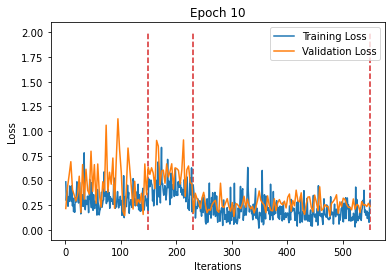

Train



Sequence:1, Seq Training Mean Loss: 0.30922655691236456, Seq Training Acc: 0.864513422818792
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3844970521735556, Seq Training Acc: 0.8337191358024691
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1821378259187412, Seq Training Acc: 0.923250786163522
******************************************************************
Epoch:11, Epoch Training Loss Mean: 0.24660375714302063, Epoch Training Acc: 0.8940465328467153
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4791595957108906, Seq Valid Acc: 0.8176020408163265



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5384147421077445, Seq Valid Acc: 0.7523148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1888354504305237, Seq Valid Acc: 0.9236438679245284
Epoch:11, Epoch Valid Mean Loss: 0.3188602924346924, Epoch Valid Acc: 0.8696771978021978
******************************************************************


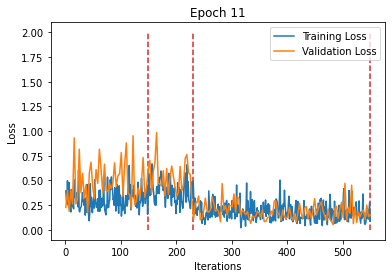

Train



Sequence:1, Seq Training Mean Loss: 0.3148688162433221, Seq Training Acc: 0.8705956375838926
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.37924936027438555, Seq Training Acc: 0.8302469135802469
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.18389063820231166, Seq Training Acc: 0.9208922955974843
******************************************************************
Epoch:12, Epoch Training Loss Mean: 0.24837933480739594, Epoch Training Acc: 0.8938184306569343
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.42262235466314824, Seq Valid Acc: 0.8329081632653061



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5194188279134256, Seq Valid Acc: 0.7546296296296297



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.19816306929262179, Seq Valid Acc: 0.9254127358490566
Epoch:12, Epoch Valid Mean Loss: 0.30625322461128235, Epoch Valid Acc: 0.8751717032967034
******************************************************************


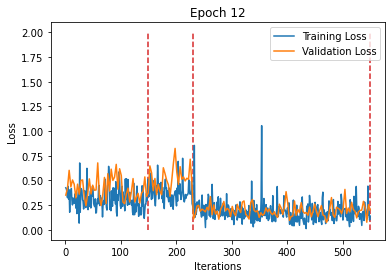

Train



Sequence:1, Seq Training Mean Loss: 0.3020815507277546, Seq Training Acc: 0.875
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3643985245330834, Seq Training Acc: 0.8383487654320988
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1791143704076889, Seq Training Acc: 0.9235455974842768
******************************************************************
Epoch:13, Epoch Training Loss Mean: 0.2399357706308365, Epoch Training Acc: 0.897753193430657
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.37382572402759473, Seq Valid Acc: 0.8514030612244898



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4618836056303095, Seq Valid Acc: 0.8020833333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1680667909951705, Seq Valid Acc: 0.9348466981132075
Epoch:13, Epoch Valid Mean Loss: 0.267051637172699, Epoch Valid Acc: 0.8926854395604396
******************************************************************


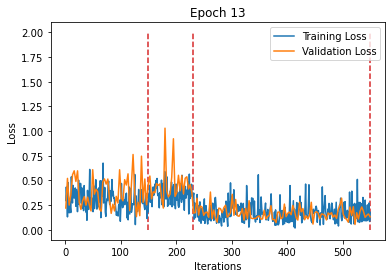

Train



Sequence:1, Seq Training Mean Loss: 0.2958369715601806, Seq Training Acc: 0.8819211409395973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3591801428500517, Seq Training Acc: 0.8422067901234568
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.18660905900991187, Seq Training Acc: 0.9321933962264151
******************************************************************
Epoch:14, Epoch Training Loss Mean: 0.24181567132472992, Epoch Training Acc: 0.9052235401459854
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5414123620305743, Seq Valid Acc: 0.7378826530612245



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6235340579792306, Seq Valid Acc: 0.6782407407407407



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.18348860122122854, Seq Valid Acc: 0.9268867924528302
Epoch:14, Epoch Valid Mean Loss: 0.3451341390609741, Epoch Valid Acc: 0.839114010989011
******************************************************************


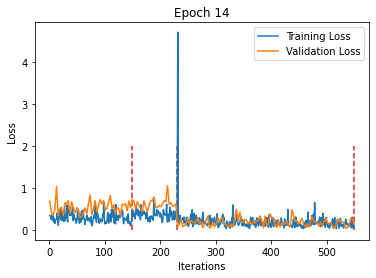

Train



Sequence:1, Seq Training Mean Loss: 0.3160568292208966, Seq Training Acc: 0.8647231543624161
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3935468989757844, Seq Training Acc: 0.8252314814814815
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15781495329461195, Seq Training Acc: 0.9330778301886793
******************************************************************
Epoch:15, Epoch Training Loss Mean: 0.23568417131900787, Epoch Training Acc: 0.8985515510948905
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3880692078750961, Seq Valid Acc: 0.8303571428571429



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.463702271382014, Seq Valid Acc: 0.7962962962962963



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16801117557399678, Seq Valid Acc: 0.921875
Epoch:15, Epoch Valid Mean Loss: 0.27112382650375366, Epoch Valid Acc: 0.8786057692307693
******************************************************************


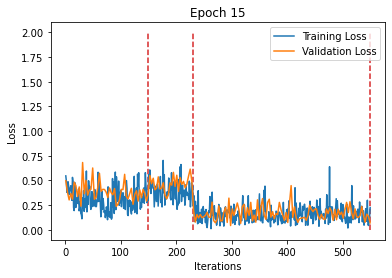

Train



Sequence:1, Seq Training Mean Loss: 0.2965840710289526, Seq Training Acc: 0.8697567114093959
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3517640951422997, Seq Training Acc: 0.8445216049382716
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.17072568198888557, Seq Training Acc: 0.9278694968553459
******************************************************************
Epoch:16, Epoch Training Loss Mean: 0.23170563578605652, Epoch Training Acc: 0.8997490875912408
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.46173629407980005, Seq Valid Acc: 0.7895408163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.576817410963553, Seq Valid Acc: 0.7071759259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.22736374211480032, Seq Valid Acc: 0.9354363207547169
Epoch:16, Epoch Valid Mean Loss: 0.34230610728263855, Epoch Valid Acc: 0.8622939560439561
******************************************************************


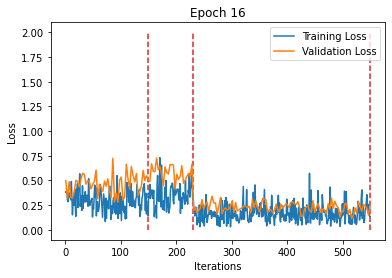

Train



Sequence:1, Seq Training Mean Loss: 0.29059262833739286, Seq Training Acc: 0.8773070469798657
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3380596551262302, Seq Training Acc: 0.8526234567901234
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.17458996534019522, Seq Training Acc: 0.9291470125786163
******************************************************************
Epoch:17, Epoch Training Loss Mean: 0.23029333353042603, Epoch Training Acc: 0.9037408759124088
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4594300188580338, Seq Valid Acc: 0.7882653061224489



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6401217226628904, Seq Valid Acc: 0.6898148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.18058498794177794, Seq Valid Acc: 0.9318985849056604
Epoch:17, Epoch Valid Mean Loss: 0.3238316774368286, Epoch Valid Acc: 0.8573145604395604
******************************************************************


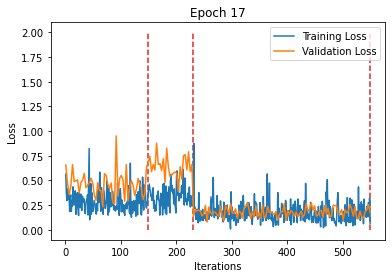

Train



Sequence:1, Seq Training Mean Loss: 0.29215712160272084, Seq Training Acc: 0.8739513422818792
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.35851047142052356, Seq Training Acc: 0.8479938271604939
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15896153673178182, Seq Training Acc: 0.9334709119496856
******************************************************************
Epoch:18, Epoch Training Loss Mean: 0.22467249631881714, Epoch Training Acc: 0.9046532846715328
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3629065940574724, Seq Valid Acc: 0.8354591836734694



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5537537402576871, Seq Valid Acc: 0.7349537037037037



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.18739584573316123, Seq Valid Acc: 0.9310141509433962
Epoch:18, Epoch Valid Mean Loss: 0.288998544216156, Epoch Valid Acc: 0.8762019230769231
******************************************************************


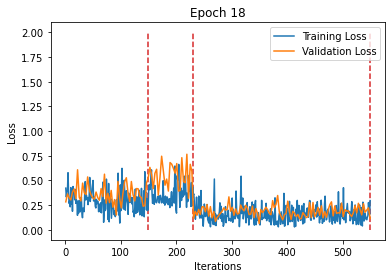

Train



Sequence:1, Seq Training Mean Loss: 0.2833216702878075, Seq Training Acc: 0.884018456375839
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3245409964411347, Seq Training Acc: 0.8580246913580247
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15403757108457433, Seq Training Acc: 0.9301297169811321
******************************************************************
Epoch:19, Epoch Training Loss Mean: 0.2143917828798294, Epoch Training Acc: 0.906934306569343
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3474395606590777, Seq Valid Acc: 0.8488520408163265



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.43819045689370895, Seq Valid Acc: 0.7870370370370371



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.20321945902311578, Seq Valid Acc: 0.917747641509434
Epoch:19, Epoch Valid Mean Loss: 0.276906281709671, Epoch Valid Acc: 0.8798076923076923
******************************************************************


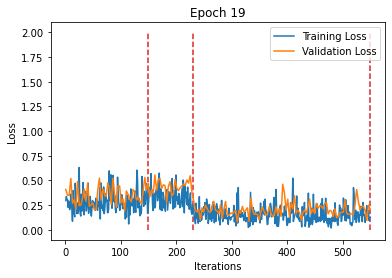

Train



Sequence:1, Seq Training Mean Loss: 0.2728981909235852, Seq Training Acc: 0.8886325503355704
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3507693950776701, Seq Training Acc: 0.8410493827160493
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15183636424301555, Seq Training Acc: 0.9352397798742138
******************************************************************
Epoch:20, Epoch Training Loss Mean: 0.21415714919567108, Epoch Training Acc: 0.9086450729927007
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.36606840606854885, Seq Valid Acc: 0.8348214285714286



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4567893423415996, Seq Valid Acc: 0.8043981481481481



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.19061248292619326, Seq Valid Acc: 0.9201061320754716
Epoch:20, Epoch Valid Mean Loss: 0.2773383855819702, Epoch Valid Acc: 0.8799793956043956
******************************************************************


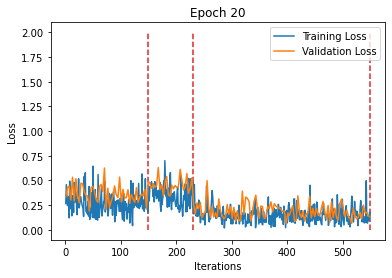

Train



Sequence:1, Seq Training Mean Loss: 0.2750236325015958, Seq Training Acc: 0.8871644295302014
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3573701528855312, Seq Training Acc: 0.8460648148148148
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15457893324922184, Seq Training Acc: 0.9334709119496856
******************************************************************
Epoch:21, Epoch Training Loss Mean: 0.21730220317840576, Epoch Training Acc: 0.9079607664233577
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4279873258605295, Seq Valid Acc: 0.8125



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5341050680036898, Seq Valid Acc: 0.7256944444444444



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1422322078274106, Seq Valid Acc: 0.9419221698113207
Epoch:21, Epoch Valid Mean Loss: 0.27730125188827515, Epoch Valid Acc: 0.875
******************************************************************


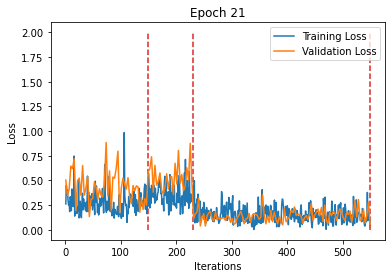

Train



Sequence:1, Seq Training Mean Loss: 0.2671502360061511, Seq Training Acc: 0.8844379194630873
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.34933000711011297, Seq Training Acc: 0.8433641975308642
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.14857276213946957, Seq Training Acc: 0.9374017295597484
******************************************************************
Epoch:22, Epoch Training Loss Mean: 0.21048767864704132, Epoch Training Acc: 0.9091012773722628
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3884072721916802, Seq Valid Acc: 0.8475765306122449



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4881607746636426, Seq Valid Acc: 0.7800925925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.18696156228488348, Seq Valid Acc: 0.9209905660377359
Epoch:22, Epoch Valid Mean Loss: 0.28588032722473145, Epoch Valid Acc: 0.8803228021978022
******************************************************************


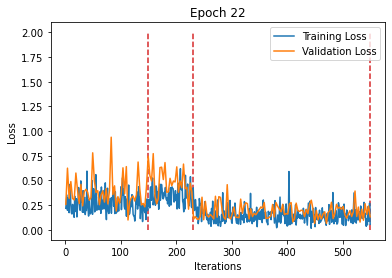

Train



Sequence:1, Seq Training Mean Loss: 0.26366089859464825, Seq Training Acc: 0.8934563758389261
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3424294228539055, Seq Training Acc: 0.8472222222222222
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1414249627997384, Seq Training Acc: 0.9383844339622641
******************************************************************
Epoch:23, Epoch Training Loss Mean: 0.2043711543083191, Epoch Training Acc: 0.9126938868613139
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5950520771498583, Seq Valid Acc: 0.8284438775510204



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.693215321611475, Seq Valid Acc: 0.7627314814814815



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.17987702913441747, Seq Valid Acc: 0.9239386792452831
Epoch:23, Epoch Valid Mean Loss: 0.3678095042705536, Epoch Valid Acc: 0.8743131868131868
******************************************************************


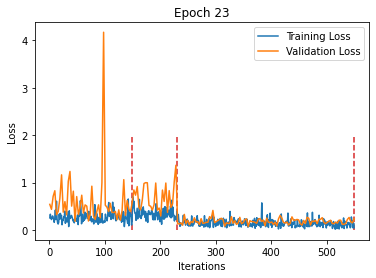

Train



Sequence:1, Seq Training Mean Loss: 0.2776713848314029, Seq Training Acc: 0.8865352348993288
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.346472868764842, Seq Training Acc: 0.8402777777777778
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.14552894255450968, Seq Training Acc: 0.9375
******************************************************************
Epoch:24, Epoch Training Loss Mean: 0.21115975081920624, Epoch Training Acc: 0.9092723540145985
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.39045392280938673, Seq Valid Acc: 0.8341836734693877



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5629550726325424, Seq Valid Acc: 0.7268518518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1967897209215839, Seq Valid Acc: 0.9336674528301887
Epoch:24, Epoch Valid Mean Loss: 0.30325132608413696, Epoch Valid Acc: 0.8762019230769231
******************************************************************


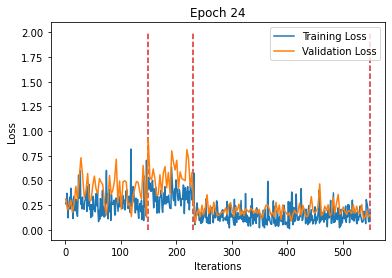

Train



Sequence:1, Seq Training Mean Loss: 0.2780243096835661, Seq Training Acc: 0.8852768456375839
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.347306685683168, Seq Training Acc: 0.8429783950617284
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1435891619514463, Seq Training Acc: 0.938187893081761
******************************************************************
Epoch:25, Epoch Training Loss Mean: 0.2102532982826233, Epoch Training Acc: 0.9097285583941606
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3605735198575623, Seq Valid Acc: 0.8520408163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5512985333248421, Seq Valid Acc: 0.8090277777777778



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14641531261633028, Seq Valid Acc: 0.9398584905660378
Epoch:25, Epoch Valid Mean Loss: 0.2641383707523346, Epoch Valid Acc: 0.8968063186813187
******************************************************************


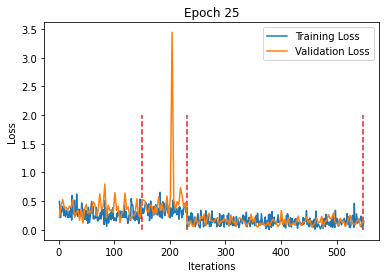

Train



Sequence:1, Seq Training Mean Loss: 0.2517534133371891, Seq Training Acc: 0.8913590604026845
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3028461181179241, Seq Training Acc: 0.8676697530864198
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.14518501954123894, Seq Training Acc: 0.9397602201257862
******************************************************************
Epoch:26, Epoch Training Loss Mean: 0.19746465981006622, Epoch Training Acc: 0.9159443430656934
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.38058576474384387, Seq Valid Acc: 0.84375



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.46981351960588386, Seq Valid Acc: 0.7916666666666666



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1551310692052796, Seq Valid Acc: 0.9413325471698113
Epoch:26, Epoch Valid Mean Loss: 0.2625140845775604, Epoch Valid Acc: 0.8928571428571429
******************************************************************


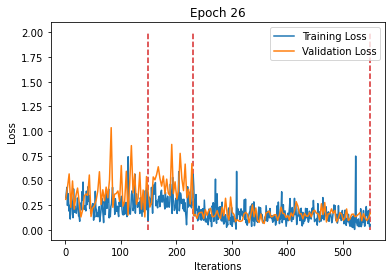

Train



Sequence:1, Seq Training Mean Loss: 0.27094416552842066, Seq Training Acc: 0.8835989932885906
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3186604888350875, Seq Training Acc: 0.8630401234567902
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.14901754808899179, Seq Training Acc: 0.9366155660377359
******************************************************************
Epoch:27, Epoch Training Loss Mean: 0.20724409818649292, Epoch Training Acc: 0.9113252737226277
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3720081612771871, Seq Valid Acc: 0.8418367346938775



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5011971029970381, Seq Valid Acc: 0.7638888888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14154943472371911, Seq Valid Acc: 0.9454599056603774
Epoch:27, Epoch Valid Mean Loss: 0.25695034861564636, Epoch Valid Acc: 0.890625
******************************************************************


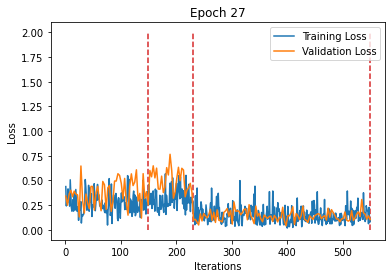

Train



Sequence:1, Seq Training Mean Loss: 0.26250203323844296, Seq Training Acc: 0.8909395973154363
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3258762815852224, Seq Training Acc: 0.8522376543209876
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13105314609495067, Seq Training Acc: 0.9477201257861635
******************************************************************
Epoch:28, Epoch Training Loss Mean: 0.19559065997600555, Epoch Training Acc: 0.9181683394160584
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.44094654187864185, Seq Valid Acc: 0.8469387755102041



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4887044429779053, Seq Valid Acc: 0.7835648148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.15280819199276421, Seq Valid Acc: 0.9469339622641509
Epoch:28, Epoch Valid Mean Loss: 0.28021466732025146, Epoch Valid Acc: 0.8957760989010989
******************************************************************


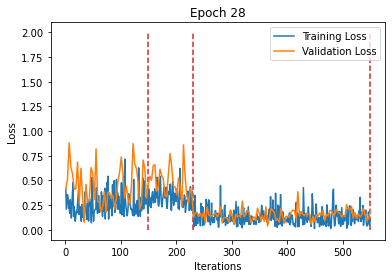

Train



Sequence:1, Seq Training Mean Loss: 0.26397736270555716, Seq Training Acc: 0.8936661073825504
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3268643812632855, Seq Training Acc: 0.8584104938271605
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13536531706604193, Seq Training Acc: 0.9442806603773585
******************************************************************
Epoch:29, Epoch Training Loss Mean: 0.19864016771316528, Epoch Training Acc: 0.9178261861313869
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.37735617099976054, Seq Valid Acc: 0.8424744897959183



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5306006570657095, Seq Valid Acc: 0.7662037037037037



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.13908094800305817, Seq Valid Acc: 0.9472287735849056
Epoch:29, Epoch Valid Mean Loss: 0.2613145709037781, Epoch Valid Acc: 0.8921703296703297
******************************************************************


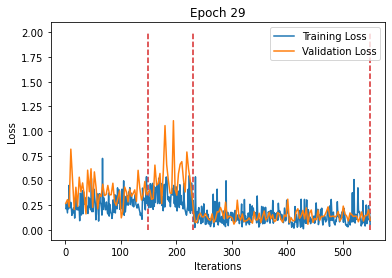

Train



Sequence:1, Seq Training Mean Loss: 0.24935464245961017, Seq Training Acc: 0.8999580536912751
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3013836161957847, Seq Training Acc: 0.8603395061728395
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12105272937809124, Seq Training Acc: 0.9485062893081762
******************************************************************
Epoch:30, Epoch Training Loss Mean: 0.1825924962759018, Epoch Training Acc: 0.9222741788321168
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.43270584271878615, Seq Valid Acc: 0.8463010204081632



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5149187092427854, Seq Valid Acc: 0.8055555555555556



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.13207111201899233, Seq Valid Acc: 0.9419221698113207
Epoch:30, Epoch Valid Mean Loss: 0.2698073089122772, Epoch Valid Acc: 0.8959478021978022
******************************************************************


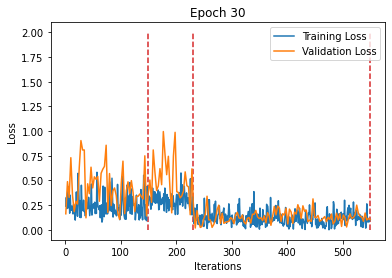

Train



Sequence:1, Seq Training Mean Loss: 0.23245525615127294, Seq Training Acc: 0.9026845637583892
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29981501860383114, Seq Training Acc: 0.8665123456790124
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13524209871396142, Seq Training Acc: 0.9467374213836478
******************************************************************
Epoch:31, Epoch Training Loss Mean: 0.18599969148635864, Epoch Training Acc: 0.9229014598540146
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.47231761442155257, Seq Valid Acc: 0.8233418367346939



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7552023982560193, Seq Valid Acc: 0.7280092592592593



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14563269182196203, Seq Valid Acc: 0.9439858490566038
Epoch:31, Epoch Valid Mean Loss: 0.3240170180797577, Epoch Valid Acc: 0.8794642857142857
******************************************************************


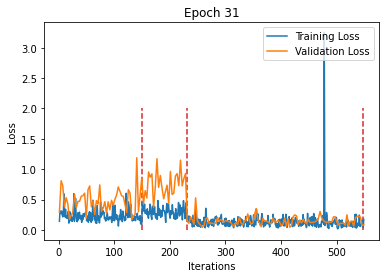

Train



Sequence:1, Seq Training Mean Loss: 0.25287147541374166, Seq Training Acc: 0.8993288590604027
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3090491029951308, Seq Training Acc: 0.8641975308641975
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1314923120838291, Seq Training Acc: 0.9431996855345912
******************************************************************
Epoch:32, Epoch Training Loss Mean: 0.1907397359609604, Epoch Training Acc: 0.9195939781021898
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3004692237900228, Seq Valid Acc: 0.8813775510204082



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4070453886632566, Seq Valid Acc: 0.8206018518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.15748374961878894, Seq Valid Acc: 0.9433962264150944
Epoch:32, Epoch Valid Mean Loss: 0.23300272226333618, Epoch Valid Acc: 0.9084821428571429
******************************************************************


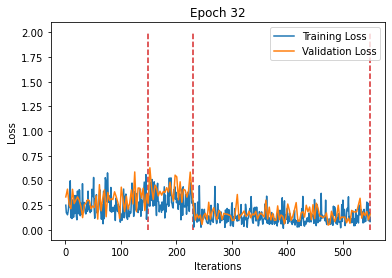

Train



Sequence:1, Seq Training Mean Loss: 0.25310755591064493, Seq Training Acc: 0.8966023489932886
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3031413148582717, Seq Training Acc: 0.8653549382716049
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12700716884654462, Seq Training Acc: 0.9429048742138365
******************************************************************
Epoch:33, Epoch Training Loss Mean: 0.1873280256986618, Epoch Training Acc: 0.9188526459854015
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.34491237967598193, Seq Valid Acc: 0.8692602040816326



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4742405966476158, Seq Valid Acc: 0.7939814814814815



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.13670369160344015, Seq Valid Acc: 0.9475235849056604
Epoch:33, Epoch Valid Mean Loss: 0.24283404648303986, Epoch Valid Acc: 0.9036744505494505
******************************************************************


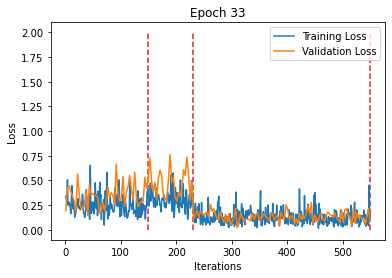

Train



Sequence:1, Seq Training Mean Loss: 0.23587626398809805, Seq Training Acc: 0.897231543624161
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2996657626864351, Seq Training Acc: 0.8595679012345679
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12990754066656032, Seq Training Acc: 0.94437893081761
******************************************************************
Epoch:34, Epoch Training Loss Mean: 0.183812215924263, Epoch Training Acc: 0.9190237226277372
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2761975155801189, Seq Valid Acc: 0.8769132653061225



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4046391761965222, Seq Valid Acc: 0.8113425925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.11673701289197747, Seq Valid Acc: 0.9525353773584906
Epoch:34, Epoch Valid Mean Loss: 0.20237943530082703, Epoch Valid Acc: 0.9112293956043956
******************************************************************


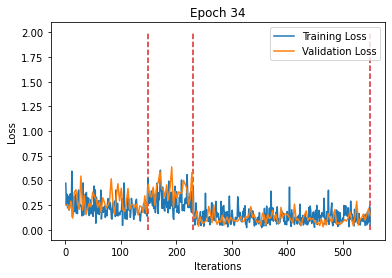

Train



Sequence:1, Seq Training Mean Loss: 0.24027502389262187, Seq Training Acc: 0.8970218120805369
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2973459361144054, Seq Training Acc: 0.8657407407407407
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12042004094054957, Seq Training Acc: 0.9474253144654088
******************************************************************
Epoch:35, Epoch Training Loss Mean: 0.17915979027748108, Epoch Training Acc: 0.921646897810219
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2833644128879722, Seq Valid Acc: 0.8807397959183674



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.42795717385080123, Seq Valid Acc: 0.8113425925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.131264199625771, Seq Valid Acc: 0.9519457547169812
Epoch:35, Epoch Valid Mean Loss: 0.2162291556596756, Epoch Valid Acc: 0.9119162087912088
******************************************************************


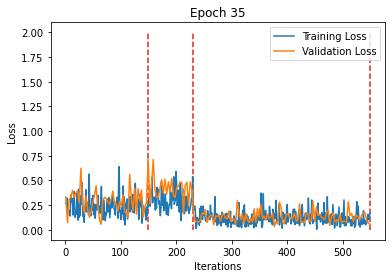

Train



Sequence:1, Seq Training Mean Loss: 0.23815892596772853, Seq Training Acc: 0.9064597315436241
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27498200204637313, Seq Training Acc: 0.8746141975308642
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11944394414869589, Seq Training Acc: 0.9479166666666666
******************************************************************
Epoch:36, Epoch Training Loss Mean: 0.1747123897075653, Epoch Training Acc: 0.9258097627737226
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.31265910000217206, Seq Valid Acc: 0.8641581632653061



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4177334744621206, Seq Valid Acc: 0.8171296296296297



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1187899381554914, Seq Valid Acc: 0.9487028301886793
Epoch:36, Epoch Valid Mean Loss: 0.21533425152301788, Epoch Valid Acc: 0.9064217032967034
******************************************************************


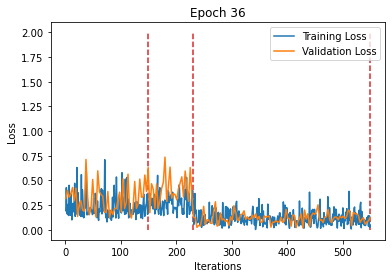

Train



Sequence:1, Seq Training Mean Loss: 0.24613236740931568, Seq Training Acc: 0.8963926174496645
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2889972838722629, Seq Training Acc: 0.8665123456790124
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1244319312321315, Seq Training Acc: 0.9460495283018868
******************************************************************
Epoch:37, Epoch Training Loss Mean: 0.1818464696407318, Epoch Training Acc: 0.9207915145985401
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4372290351561138, Seq Valid Acc: 0.8341836734693877



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6569182905885909, Seq Valid Acc: 0.7627314814814815



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.11862569109027116, Seq Valid Acc: 0.9498820754716981
Epoch:37, Epoch Valid Mean Loss: 0.2842601239681244, Epoch Valid Acc: 0.8909684065934066
******************************************************************


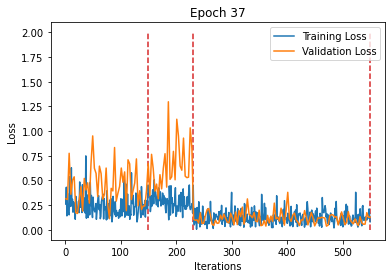

Train



Sequence:1, Seq Training Mean Loss: 0.23096265198800386, Seq Training Acc: 0.9054110738255033
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2940137075421251, Seq Training Acc: 0.8695987654320988
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11275165942907568, Seq Training Acc: 0.9478183962264151
******************************************************************
Epoch:38, Epoch Training Loss Mean: 0.1716853529214859, Epoch Training Acc: 0.9247262773722628
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.347205643447078, Seq Valid Acc: 0.8622448979591837



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.42736699570108344, Seq Valid Acc: 0.8113425925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1418014819259351, Seq Valid Acc: 0.9436910377358491
Epoch:38, Epoch Valid Mean Loss: 0.23946674168109894, Epoch Valid Acc: 0.9021291208791209
******************************************************************


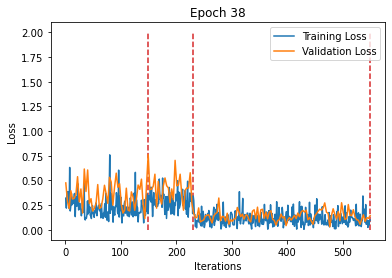

Train



Sequence:1, Seq Training Mean Loss: 0.24308452315178494, Seq Training Acc: 0.8982802013422819
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2624435869080049, Seq Training Acc: 0.8831018518518519
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.108000238282524, Seq Training Acc: 0.9529284591194969
******************************************************************
Epoch:39, Epoch Training Loss Mean: 0.16755767166614532, Epoch Training Acc: 0.9277486313868614
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2950309508917283, Seq Valid Acc: 0.8839285714285714



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4135028590206747, Seq Valid Acc: 0.8009259259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10973853751454714, Seq Valid Acc: 0.953125
Epoch:39, Epoch Valid Mean Loss: 0.2046889066696167, Epoch Valid Acc: 0.9119162087912088
******************************************************************


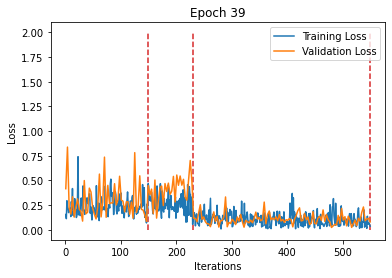

Train



Sequence:1, Seq Training Mean Loss: 0.22912050691126978, Seq Training Acc: 0.9018456375838926
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.28835947112536725, Seq Training Acc: 0.8680555555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11425589077590537, Seq Training Acc: 0.9533215408805031
******************************************************************
Epoch:40, Epoch Training Loss Mean: 0.17122161388397217, Epoch Training Acc: 0.9267221715328468
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.413267118894324, Seq Valid Acc: 0.8335459183673469



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4510171805266981, Seq Valid Acc: 0.8009259259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10911028396408513, Seq Valid Acc: 0.9554834905660378
Epoch:40, Epoch Valid Mean Loss: 0.24172112345695496, Epoch Valid Acc: 0.8997252747252747
******************************************************************


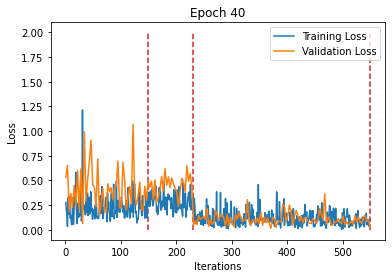

Train



Sequence:1, Seq Training Mean Loss: 0.2280664586980871, Seq Training Acc: 0.9114932885906041
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2791127097091557, Seq Training Acc: 0.8665123456790124
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10524574258663463, Seq Training Acc: 0.9522405660377359
******************************************************************
Epoch:41, Epoch Training Loss Mean: 0.16433975100517273, Epoch Training Acc: 0.9284899635036497
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4111928021421238, Seq Valid Acc: 0.8558673469387755



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.43406363880192794, Seq Valid Acc: 0.8217592592592593



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.11633679103809146, Seq Valid Acc: 0.9543042452830188
Epoch:41, Epoch Valid Mean Loss: 0.24285641312599182, Epoch Valid Acc: 0.9081387362637363
******************************************************************


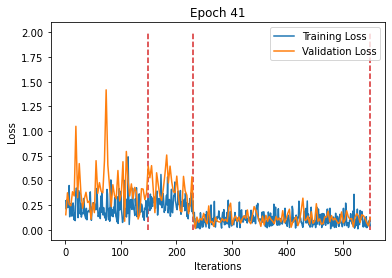

Train



Sequence:1, Seq Training Mean Loss: 0.22954719273636004, Seq Training Acc: 0.9072986577181208
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27702867340894394, Seq Training Acc: 0.8757716049382716
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.09773834026418626, Seq Training Acc: 0.9592177672955975
******************************************************************
Epoch:42, Epoch Training Loss Mean: 0.16007782518863678, Epoch Training Acc: 0.9327668795620438
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30353398735121806, Seq Valid Acc: 0.8743622448979592



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.3580144726567798, Seq Valid Acc: 0.8333333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10416616889525135, Seq Valid Acc: 0.9590212264150944
Epoch:42, Epoch Valid Mean Loss: 0.1955009549856186, Epoch Valid Acc: 0.9175824175824175
******************************************************************


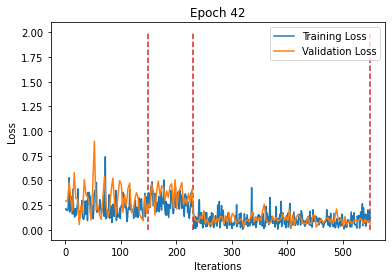

Train



Sequence:1, Seq Training Mean Loss: 0.21937392247003196, Seq Training Acc: 0.9121224832214765
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.24667780156488772, Seq Training Acc: 0.8896604938271605
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10806548522504152, Seq Training Acc: 0.952437106918239
******************************************************************
Epoch:43, Epoch Training Loss Mean: 0.158818319439888, Epoch Training Acc: 0.9321966240875912
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30396811983415056, Seq Valid Acc: 0.8858418367346939



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4148726639924226, Seq Valid Acc: 0.8148148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.133826703307623, Seq Valid Acc: 0.9584316037735849
Epoch:43, Epoch Valid Mean Loss: 0.22132764756679535, Epoch Valid Acc: 0.9175824175824175
******************************************************************


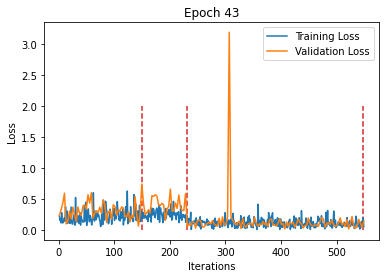

Train



Sequence:1, Seq Training Mean Loss: 0.2153583500509294, Seq Training Acc: 0.90625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2472084417571256, Seq Training Acc: 0.8892746913580247
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10621464474759293, Seq Training Acc: 0.9535180817610063
******************************************************************
Epoch:44, Epoch Training Loss Mean: 0.15673090517520905, Epoch Training Acc: 0.9311701642335767
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3025751252259527, Seq Valid Acc: 0.8762755102040817



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4263656095222191, Seq Valid Acc: 0.8125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12028799687494647, Seq Valid Acc: 0.9498820754716981
Epoch:44, Epoch Valid Mean Loss: 0.21477240324020386, Epoch Valid Acc: 0.9096840659340659
******************************************************************


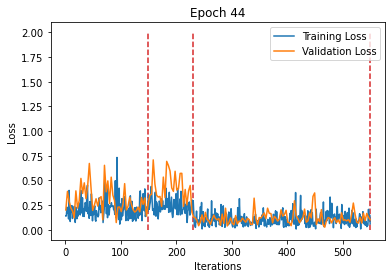

Train



Sequence:1, Seq Training Mean Loss: 0.2312191024722669, Seq Training Acc: 0.9068791946308725
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2624143283860183, Seq Training Acc: 0.8881172839506173
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.09747337823244596, Seq Training Acc: 0.9591194968553459
******************************************************************
Epoch:45, Epoch Training Loss Mean: 0.15821850299835205, Epoch Training Acc: 0.9344206204379562
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.33404435749564854, Seq Valid Acc: 0.8711734693877551



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.40819952333414994, Seq Valid Acc: 0.8148148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10920578364353135, Seq Valid Acc: 0.9543042452830188
Epoch:45, Epoch Valid Mean Loss: 0.21409545838832855, Epoch Valid Acc: 0.9112293956043956
******************************************************************


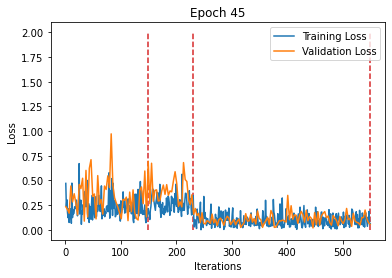

Train



Sequence:1, Seq Training Mean Loss: 0.1892407372493872, Seq Training Acc: 0.927013422818792
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27508850818798863, Seq Training Acc: 0.8753858024691358
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10763862136013384, Seq Training Acc: 0.9537146226415094
******************************************************************
Epoch:46, Epoch Training Loss Mean: 0.1545768529176712, Epoch Training Acc: 0.9348768248175182
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.34128876015239834, Seq Valid Acc: 0.8596938775510204



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.44552431724689623, Seq Valid Acc: 0.8078703703703703



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.11083415793782135, Seq Valid Acc: 0.9575471698113207
Epoch:46, Epoch Valid Mean Loss: 0.22253145277500153, Epoch Valid Acc: 0.9089972527472527
******************************************************************


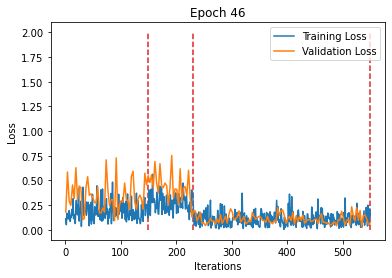

Train



Sequence:1, Seq Training Mean Loss: 0.22231798989060741, Seq Training Acc: 0.9054110738255033
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2586375118037801, Seq Training Acc: 0.8865740740740741
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10536179995990165, Seq Training Acc: 0.9537146226415094
******************************************************************
Epoch:47, Epoch Training Loss Mean: 0.1598176658153534, Epoch Training Acc: 0.9306569343065694
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3134645441052865, Seq Valid Acc: 0.8762755102040817



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.39821975816179206, Seq Valid Acc: 0.8414351851851852



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1088386300757949, Seq Valid Acc: 0.9540094339622641
Epoch:47, Epoch Valid Mean Loss: 0.20686037838459015, Epoch Valid Acc: 0.9163804945054945
******************************************************************


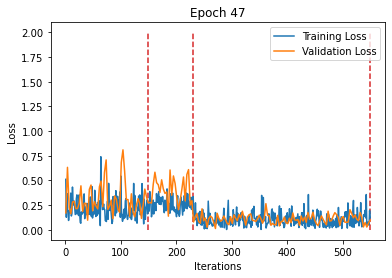

Train



Sequence:1, Seq Training Mean Loss: 0.21417667936758708, Seq Training Acc: 0.9135906040268457
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2757553380948526, Seq Training Acc: 0.8807870370370371
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10119061329864762, Seq Training Acc: 0.9561713836477987
******************************************************************
Epoch:48, Epoch Training Loss Mean: 0.15771372616291046, Epoch Training Acc: 0.9334511861313869
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.34165420094314886, Seq Valid Acc: 0.8558673469387755



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4148895663243753, Seq Valid Acc: 0.8240740740740741



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10643641355465043, Seq Valid Acc: 0.9590212264150944
Epoch:48, Epoch Valid Mean Loss: 0.21552380919456482, Epoch Valid Acc: 0.9112293956043956
******************************************************************


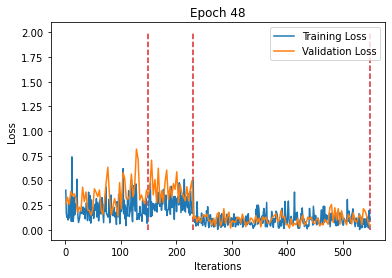

Train



Sequence:1, Seq Training Mean Loss: 0.22066540698577095, Seq Training Acc: 0.90625
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.26574689821328645, Seq Training Acc: 0.8804012345679012
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.09779984312594733, Seq Training Acc: 0.9559748427672956
******************************************************************
Epoch:49, Epoch Training Loss Mean: 0.15603099763393402, Epoch Training Acc: 0.9312842153284672
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30578501705004246, Seq Valid Acc: 0.8698979591836735



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4542786799095295, Seq Valid Acc: 0.8055555555555556



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10388709636369967, Seq Valid Acc: 0.9560731132075472
Epoch:49, Epoch Valid Mean Loss: 0.2102254033088684, Epoch Valid Acc: 0.9105425824175825
******************************************************************


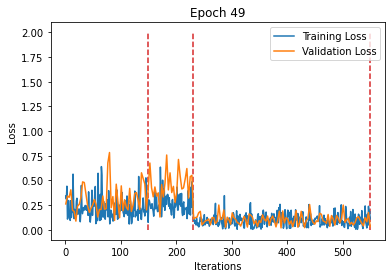

Train



Sequence:1, Seq Training Mean Loss: 0.21651041687734976, Seq Training Acc: 0.9114932885906041
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.25619307178774, Seq Training Acc: 0.8869598765432098
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1024861920525396, Seq Training Acc: 0.9555817610062893
******************************************************************
Epoch:50, Epoch Training Loss Mean: 0.1562085747718811, Epoch Training Acc: 0.9334511861313869
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3590471957411085, Seq Valid Acc: 0.8590561224489796



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4335912156988073, Seq Valid Acc: 0.7997685185185185



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.10937174592378004, Seq Valid Acc: 0.9528301886792453
Epoch:50, Epoch Valid Mean Loss: 0.22469055652618408, Epoch Valid Acc: 0.9048763736263736
******************************************************************


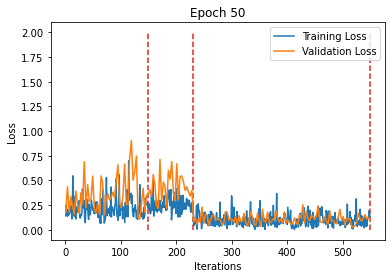


Save Model
Finished Training


In [27]:
if run_train:
    writer = SummaryWriter('runs/008_Experiment_AllData_720x24_lr' + str(lr) + '_' + timestampStr)
    max_iter_per_seq = 600
    # 训练迭代总步数
    num_train_iter_per_epoch = 0
    num_train_iterations = [] # For plot parting line
    num_train_iterations_per_dl = [max_iter_per_seq if len(dl)>= max_iter_per_seq else len(dl) for dl in train_dls]
    for seq_dataloaders in dataloaders:
        if len(seq_dataloaders[train_dl_idx]) <= max_iter_per_seq:
            num_train_iter_per_epoch += len(seq_dataloaders[train_dl_idx])
        else:
            num_train_iter_per_epoch += max_iter_per_seq
        num_train_iterations.append(num_train_iter_per_epoch)
    print("Total Train Iterations: ",num_train_iter_per_epoch)
    print("Total Train Iterations List: ",num_train_iterations)
        
    # 训练迭代总步数为验证迭代总步数的3倍
    num_val_iterations = [int(number / 3) for number in num_train_iterations]
    num_val_iter_per_epoch = num_val_iterations[-1]
    
    # iterations in every seq
    num_val_iter_per_seq = []
    num_val_iter_per_seq.append(num_val_iterations[0])
    for i in range(len(num_val_iterations)-1):
        diff = num_val_iterations[i+1] - num_val_iterations[i] # The latter minus the former
        num_val_iter_per_seq.append(diff)
        
    print("Valid iterations per seq: ",num_val_iter_per_seq)
        
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,eps=1e-08)

    scheduler = OneCycleLR(optimizer, num_train_iter_per_epoch, num_epochs, min_lr_factor=min_lr_factor)
    scheduler.step(epoch=0)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.
    loss_min = 0.
    
    for epoch in tqdm(range(1,num_epochs+1)):

        print('Train')

        model.train()
        
        running_corrects = 0

        train_loss_array = np.zeros(num_train_iter_per_epoch, dtype=np.single)

        # mse_y = torch.zeros(batch_sizes[0]//2).to(device)
        
        i = 0
        seq_idx = 1
        for (refs, train_dl, max_num) in zip(refs_list, train_dls, num_train_iterations_per_dl):
            # obtain the refs in every seq
            
            curr_train_dl = train_dl

            curr_refs = refs.float().to(device)

            # Training
            dl_iter = iter(curr_train_dl)
            
            # This two only used to compute the loss and acc in every Sequence
            running_loss = 0
            corrects = 0
            for idx in tqdm(range(max_num)):
                if idx >= max_iter_per_seq:
                    break
                try:
                    img1, img2, targets = next(dl_iter)

                except (StopIteration, TypeError):
                    dl_iter = iter(curr_train_dl)
                    img1, img2, targets = next(dl_iter)
                
                scheduler.zero_grad()

                img1 = img1.float().to(device)
                img2 = img2.float().to(device)
                targets = targets.view(-1)
                targets = targets.float().to(device)

                # forward pass
                loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                
                loss.backward()
                
                running_loss += loss.item()
                corrects += torch.sum(preds == targets)
                running_corrects += torch.sum(preds == targets)

                train_loss_array[i] = loss.cpu().detach().numpy()
               
                
                # record loss and accuracy per iteration
                c = torch.sum(preds == targets)
                acc = int(c) / img1.size(0)
                writer.add_scalar('Train/Loss per Iteration',train_loss_array[i], ((epoch - 1) * num_train_iter_per_epoch)+ i)
                writer.add_scalar('Train/Acc per Iteration',acc, ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                # Record the lr
                curr_lr = get_lr(optimizer)
                writer.add_scalar('Train/Learning Rate',curr_lr , ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                i += 1
                scheduler.step()
            
            # record loss and accuracy in every train dataloader (namely every Sequence)
            #seq_train_mean_loss = running_loss / len(curr_train_dl)
            #seq_train_acc = int(corrects) / (len(curr_train_dl) * img1.size(0))
            seq_train_mean_loss = running_loss / max_num
            seq_train_acc = int(corrects) / (max_num * img1.size(0))
            
            print("Sequence:{}, Seq Training Mean Loss: {}, Seq Training Acc: {}".format(seq_idx, seq_train_mean_loss, seq_train_acc))
            print("******************************************************************")
            # Record the loss and acc in every Seq in Tensorboard
            writer.add_scalar('Train/Seq Training Mean Loss',seq_train_mean_loss, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Training Accuracy', seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Error Rate',1 - seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            
            seq_idx += 1
            
        # after one epoch update scheduler   
        # Plot lr policy
        curr_lr = get_lr(optimizer)
        writer.add_scalar('Train/Learning Rate Policy',curr_lr , epoch)
        writer.flush()
            
        # record loss and accuracy in every epoch (namely 6 Sequences)
        epoch_train_mean_loss = train_loss_array.mean()  # std
        epoch_train_acc = int(running_corrects) / (num_train_iter_per_epoch * img1.size(0))

        print("Epoch:{}, Epoch Training Loss Mean: {}, Epoch Training Acc: {}".format(epoch, epoch_train_mean_loss, epoch_train_acc))
        print("******************************************************************")
        
        ### Validation
        print('Validation')
        model.eval()
        val_loss_array = np.zeros(num_val_iter_per_epoch, dtype=np.single)
        
        running_corrects = 0

        i = 0
        with torch.no_grad():
            seq_idx = 1
            for (refs, valid_dl, max_num) in zip(refs_list,valid_dls, num_val_iter_per_seq):
                
                curr_valid_dl = valid_dl
                curr_refs = refs.float().to(device)
                iter_max_num = max_num
            
                dl_iter = iter(curr_valid_dl)
                # This two uesd to compute loss and accurary in every Seq
                running_loss = 0
                corrects = 0
                for dl_idx in tqdm(range(iter_max_num)):
                    try:
                        img1, img2, targets = next(dl_iter)
                    except (StopIteration, TypeError):
                        dl_iter = iter(curr_valid_dl)
                        img1, img2, targets = next(dl_iter)

                    img1 = img1.float().to(device)
                    img2 = img2.float().to(device)
                    targets = targets.view(-1)
                    targets = targets.float().to(device)
                
                    loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
                    running_loss += loss.item()
                    corrects += torch.sum(preds == targets)
                    running_corrects += torch.sum(preds == targets)
                    
                    # record loss and accuracy in every iteration
                    c = torch.sum(preds == targets)
                    acc = int(c) / img1.size(0)
                    writer.add_scalar('Validation/Loss per Iteration',loss.item(), ((epoch - 1) * num_val_iter_per_epoch)+ i)
                    writer.add_scalar('Validation/Acc per Iteration',acc, ((epoch - 1) * num_val_iter_per_epoch)+ i)

                    val_loss_array[i] = loss.cpu().detach().numpy()
                    i += 1
            
                #seq_val_mean_loss = running_loss / len(curr_valid_dl)
                #seq_val_acc = int(corrects) / (len(curr_valid_dl) * img1.size(0))
                seq_val_mean_loss = running_loss / iter_max_num
                seq_val_acc = int(corrects) / (iter_max_num * img1.size(0))
                print("******************************************************************")
                print("Sequence:{}, Seq Valid Mean Loss: {}, Seq Valid Acc: {}".format(seq_idx,seq_val_mean_loss, seq_val_acc))
                
                writer.add_scalar('Validation/Seq Mean Loss',seq_val_mean_loss, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Accuracy', seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Error Rate',1 - seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                
                seq_idx += 1
                
            epoch_val_mean_loss = val_loss_array.mean()  # std
            epoch_val_acc = int(running_corrects) / (num_val_iter_per_epoch * img1.size(0))

            print("Epoch:{}, Epoch Valid Mean Loss: {}, Epoch Valid Acc: {}".format(epoch, epoch_val_mean_loss, epoch_val_acc))
            print("******************************************************************")
            
        # save best model weights
        if epoch_val_acc > best_acc:
            best_model_wts = copy.deepcopy(model.state_dict())
            loss_min = epoch_val_mean_loss
            
        # Tensorboard
        writer.add_scalars('Epoch/Loss', {"Training Loss": epoch_train_mean_loss,
                                          "Validation Loss": epoch_val_mean_loss}, epoch)
        writer.add_scalars('Epoch/Accuracy', {"Training Accuracy":epoch_train_acc,
                                              "Validation Accuracy": epoch_val_acc}, epoch)
        writer.add_scalars('Epoch/Error Rate', {"Training": 1 - epoch_train_acc,
                                                "Validation": 1 - epoch_val_acc}, epoch)
        writer.flush()
        
        plt.plot(np.linspace(1, train_loss_array.size+1, train_loss_array.size), train_loss_array,label='Training Loss')
        plt.plot(np.linspace(1, train_loss_array.size+1, val_loss_array.size), val_loss_array, label='Validation Loss')
        
        train_parting_line = num_train_iterations  # 1128 iterations in total in training
        val_parting_line = num_val_iterations  # 373 iterations in total in validation
        plt.vlines(train_parting_line, 0, 2, colors = "tab:red", linestyles = "dashed")
        
        plt.title('Epoch {}'.format(epoch))
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
    print("Save Model")
    torch.save(model, net_path + '/m-' + timestampStr)
    torch.save({'epoch': epoch, 
                'state_dict': best_model_wts, 
                'best_loss': loss_min,
                'optimizer': optimizer.state_dict()},
                net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
    # add model to tensorboard
    #writer.add_graph(model,(img1, curr_refs, targets))
    writer.flush()

    print('Finished Training')
        

### Test Config

In [29]:
batch_size = 32
valid_dl_idx = 1
num_test_iter_per_epoch = 0
for seq_dataloaders in dataloaders:
    num_test_iter_per_epoch += len(seq_dataloaders[2])
    
model.eval()
y_vect = np.zeros(batch_size * num_test_iter_per_epoch)
y_tilde_vect = np.zeros(batch_size * num_test_iter_per_epoch)

i = 0
with torch.no_grad():
    seq_idx = 1
    
    running_corrects = 0

    test_loss_array = np.zeros(num_test_iter_per_epoch, dtype=np.single)
    
    for (refs, test_dl) in zip(refs_list,valid_dls):
        
        curr_test_dl = test_dl
        
        curr_refs = refs.float().to(device) 

        dl_iter = iter(curr_test_dl)
        
        # This two uesd to compute loss and accurary in every Seq
        running_loss = 0
        corrects = 0

        for dl_idx in tqdm(range(len(curr_test_dl))):
            try:
                img1, img2, targets = next(dl_iter)
            except (StopIteration, TypeError):
                dl_iter = iter(curr_valid_dl)
                img1, img2, targets = next(dl_iter)

            scheduler.zero_grad()
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)
            targets = targets.view(-1)
            targets = targets.float().to(device)
              
            loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
            running_loss += loss.item()
            corrects += torch.sum(preds == targets)
            
            test_loss_array[i] = loss.cpu().detach().numpy()

            y_vect[i*batch_size:(i+1)*batch_size] = targets.detach().cpu().numpy()
            y_tilde_vect[i*batch_size:(i+1)*batch_size] = preds.detach().cpu().numpy()
            
            # record loss and accuracy per iteration
            c = torch.sum(preds == targets)
            acc = int(c) / img1.size(0)
            
            writer.add_scalar('Test/Loss per Iteration',test_loss_array[i], i)
            writer.add_scalar('Test/Acc per Iteration',acc, i)
            writer.add_scalar('Test/Error Rate', 1 - acc, i)

            i += 1
        # record seq test loss and acc
        seq_test_mean_loss = running_loss / len(curr_test_dl)
        seq_test_acc = int(corrects) / (len(curr_test_dl) * img1.size(0))
        
        print("******************************************************************")
        print("Test: Sequence:{}, Seq Mean Loss: {}, Seq Acc: {}".format(seq_idx,seq_test_mean_loss, seq_test_acc))
            
        writer.add_scalar('Test/Seq Loss', seq_test_mean_loss, seq_idx)
        writer.add_scalar('Test/Seq Accuracy', seq_test_acc, seq_idx)
        writer.add_scalar('Test/Seq Error Rate', 1 - seq_test_acc, seq_idx)
        
        seq_idx += 1

writer.close()
                                      
print("Test finished")


******************************************************************
Test: Sequence:1, Seq Mean Loss: 0.3245861131925972, Seq Acc: 0.8673469387755102



******************************************************************
Test: Sequence:2, Seq Mean Loss: 0.44517570292508163, Seq Acc: 0.8009259259259259



******************************************************************
Test: Sequence:3, Seq Mean Loss: 0.10883452499039331, Seq Acc: 0.9528301886792453
Test finished


### Init test dataset for plotting degradation metrics 

In [30]:
def init_test_dataset(path,seq_idx_list,mean_val,std_val):

    ds_h5 = []
    refs_list = []

    img_transforms = [RandomRotateGrayscale(rot_range=[-0.1, 0.1], fill=150),
                      RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    # to obtain the Seq data
    for seq_idx in seq_idx_list:
        h5_fpath = path.format(seq_idx)
        h5_f = DatasetH5ForTest(h5_fpath, normalize_im=False, transform = composed_img_transforms)
        
        # obtain the references, the first 32 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [32]:
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 2,3,4
combined_path_type2 = os.path.join(data_path_type2, fnames_type2)
seq_idx_list_type2 = [1,2,3,4]

In [ ]:
type2_data = True
if type2_data:
    # Type 2 Data New Regenerated
    data_path = "../MA/NewData/21503_1000200411_653340003"
    fnames = "regenerated_roi_ms1_seq{}_720x30.h5"

    combined_path = os.path.join(data_path, fnames)
    seq_idx_list = [1,2,3,4]

In [33]:
mean_val = 0
std_val = 255
refs_list, ds_h5_test = init_test_dataset(combined_path_type2, seq_idx_list_type2, mean_val, std_val)

In [34]:
ds_h5_test

#### init dataloader

In [35]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

### Degradation metrics function

In [36]:
def degradation_metrics(v1, refs_tensor):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = refs_tensor.size(0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

In [37]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('ResNet34_1stripe_720x24_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

15279



7995



4322



17013


<IPython.core.display.Javascript object>


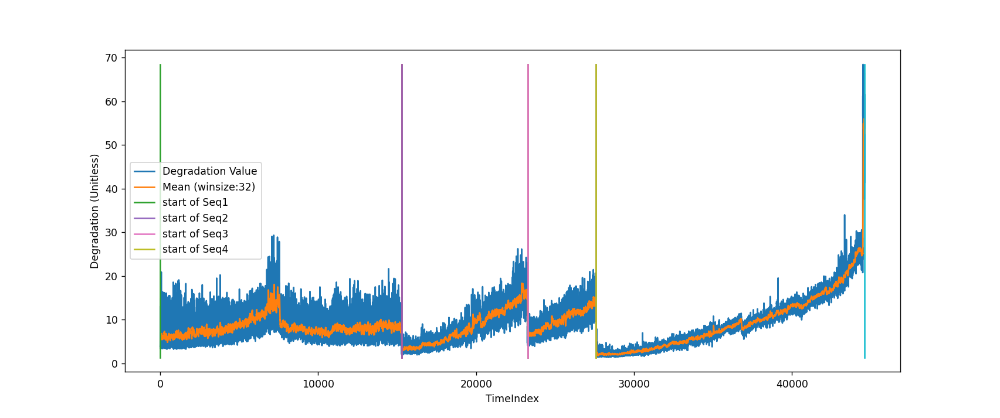

In [38]:
%matplotlib notebook
plt.plot(all_seq_y_tilde_vect, label='Degradation Value')
plt.plot(pd.Series(all_seq_y_tilde_vect).rolling(32).mean(), label='Mean (winsize:32)')

min_y = all_seq_y_tilde_vect.min()
max_y = all_seq_y_tilde_vect.max()


# Type 2 Data
seq_period_iloc = [
    [    0,  15279],
    [ 15279, 23274],
    [ 23274, 27596],
    [ 27596, 44609],
]

seq_index = 1
for stime_iloc, etime_iloc in seq_period_iloc:
    plt.plot([stime_iloc, stime_iloc], [min_y, max_y], label = "start of Seq{}".format(seq_index))
    plt.plot([etime_iloc, etime_iloc], [min_y, max_y])
    seq_index += 1


plt.ylabel("Degradation (Unitless)")
plt.xlabel("TimeIndex")

plt.legend()
plt.show()

In [39]:
import plotly.graph_objects as go

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        name = 'Degradation Metric',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        name = 'Mean(Windowsize:32)',
        #mode='lines+markers',
    )
)

In [40]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

## To see the intmediate feature

In [41]:
feature_output1 = model.feature_extractor.featuremap1.transpose(1,0).cpu()
feature_output2 = model.feature_extractor.featuremap2.transpose(1,0).cpu()
feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output3.shape

torch.Size([64, 10])

In [42]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((2, 1, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(5,5))
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

<IPython.core.display.Javascript object>


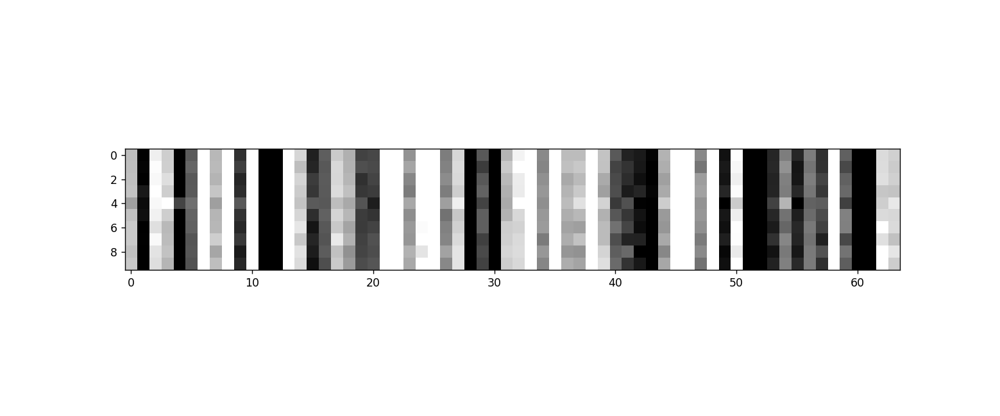

In [43]:
out = torchvision.utils.make_grid(feature_output3)
feature_imshow(out)

In [47]:
dl = test_dataloaders[1]
refs = refs_list[1]

curr_refs = refs.float().to(device)
num_data = len(dl)
print(num_data)
    
loss_vect = np.zeros(num_data)
var_res_vect= np.zeros(num_data)

y_vect = np.zeros(num_data)
y_tilde_vect = np.zeros(num_data)

dl_iter = iter(dl)

for i in tqdm(range(1)):
    try:
        img,label = next(dl_iter)

    except (StopIteration, TypeError):
        dl_iter = iter(curr_train_dl)
        img,label = next(dl_iter)

    y_vect[i] = label

    img = img.float().to(device)
    
    feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
    
    latent_vector = model.featuremap(img)
    refs_latent_vectors = model.featuremap_refs(curr_refs)
    
    output1 = latent_vector.transpose(1,0).cpu()
    output_refs = refs_latent_vectors.transpose(1,0).cpu()

    y_tilde = metric.detach().cpu().numpy()

    var_res_vect[i] = np.var(y_tilde)

    y_tilde_vect[i] = y_tilde.mean()

    loss_vect[i] = np.abs(label - y_tilde_vect[i])

7995


AttributeError: 'RefBasedDeepMetric' object has no attribute 'featuremap'

In [ ]:
out = torchvision.utils.make_grid(output1)
feature_imshow(out)

In [ ]:
out = torchvision.utils.make_grid(output_refs)
feature_imshow(out)

# Load Model und Test by using several Seqs data

In [ ]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

In [ ]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []

for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs
    curr_refs = [ref.float().to(device) for ref in curr_refs]
    
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        v1, refs_v = model.forward_test(img, curr_refs)
        metric = degradation_metrics(v1,refs_v)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    time_ids.append(y_tilde_vect.size)
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

In [ ]:
fig = go.Figure()

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        #mode='lines+markers',
    )
)